In [1]:
import warnings
warnings.filterwarnings("ignore")

In [2]:
import tensorflow as tf
print(tf.__version__)

2.6.0


# Step 1. 모델 학습을 위한 데이터셋 준비

In [3]:
import tensorflow_datasets as tfds

tfds.__version__

'4.4.0'

In [4]:
# tf_flowers 데이터셋 다운로드 및 데이터셋 분할
(raw_train, raw_validation, raw_test), metadata = tfds.load(
    name='tf_flowers',
    split=['train[:80%]', 'train[80%:90%]', 'train[90%:]'],
    with_info=True,  
    as_supervised=True,
)

In [5]:
# 각 데이터셋의 확인해보기
print(raw_train)
print(raw_validation)
print(raw_test)

<PrefetchDataset shapes: ((None, None, 3), ()), types: (tf.uint8, tf.int64)>
<PrefetchDataset shapes: ((None, None, 3), ()), types: (tf.uint8, tf.int64)>
<PrefetchDataset shapes: ((None, None, 3), ()), types: (tf.uint8, tf.int64)>


- 3차원 데이터, img크기가 전부 다르기 때문에 None으로 나타남

In [6]:
# 학습 데이터에서 1개 샘플 가져와 img, label 구체적으로 확인
for image, label in raw_train.take(1):
    print(f'Image shape: {image.shape}')
    print(f'Label: {label}')

Image shape: (333, 500, 3)
Label: 2


# Step 2. 데이터셋을 모델에 넣을 수 있는 형태로 준비하기

In [7]:
import tensorflow as tf
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

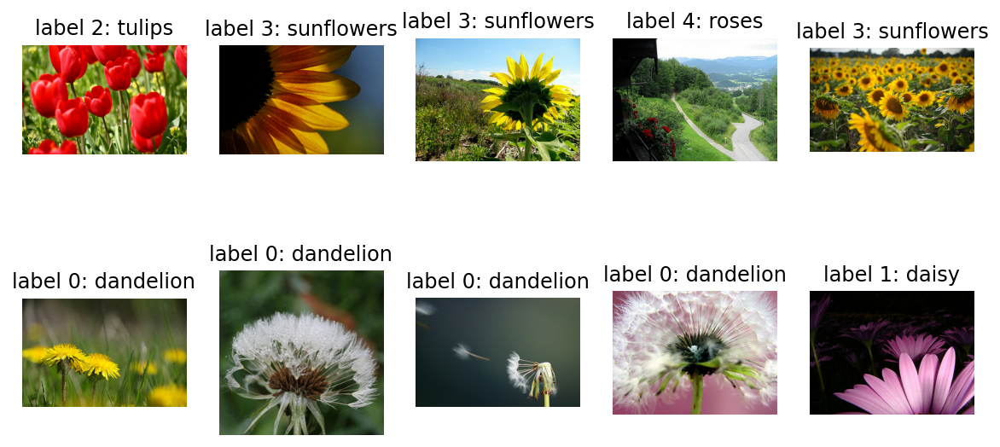

In [8]:
# raw_train안에 있는 데이터 확인을 위해 tf.data.Dataset에서 제공하는 take 함수 사용해보기
plt.figure(figsize=(10, 5))

# 라벨을 정수에서 문자열로 변환
get_label_name = metadata.features['label'].int2str

# raw_train 데이터셋에서 10개의 이미지를 가져와 시각화
for idx, (image, label) in enumerate(raw_train.take(10)):
    plt.subplot(2, 5, idx+1)
    plt.imshow(image)
    plt.title(f'label {label}: {get_label_name(label)}')
    plt.axis('off')

plt.show()

- label들이 0~4까지 섞여있음
- 이미지 사이즈가 전부 상이해 사이즈 통일이 필요

In [9]:
# 이미지 정규화, 리사이징
IMG_SIZE = 160

def format_example(image, label):
    image = tf.cast(image, tf.float32)
    image = (image / 127.5) - 1  # 픽셀 값을 [0, 1] 범위로 정규화
    image = tf.image.resize(image, (IMG_SIZE, IMG_SIZE))
    return image, label

- 'image = (image/127.5) - 1'일 경우
    - 이미지 픽셀 값을 [-1, 1] 범위로 정규화
    - 특정 신경망 구조나 사전학습된 모델에서 사용(VGG16, ResNet 등)
- 'image = image / 255.0'의 경우
    - 이미지 픽셀 값을 [0, 1]범위로 정규화
    - 일반적으로 널리 사용

In [10]:
# 학습, 검증, 테스트 데이터셋에 format_example 함수 적용
train = raw_train.map(format_example)
validation = raw_validation.map(format_example)
test = raw_test.map(format_example)

print(train)
print(validation)
print(test)

<MapDataset shapes: ((160, 160, 3), ()), types: (tf.float32, tf.int64)>
<MapDataset shapes: ((160, 160, 3), ()), types: (tf.float32, tf.int64)>
<MapDataset shapes: ((160, 160, 3), ()), types: (tf.float32, tf.int64)>


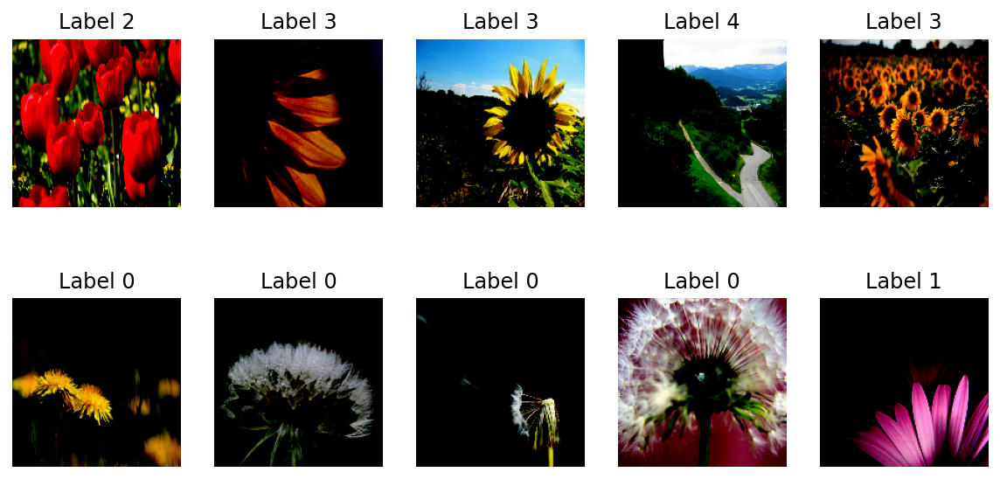

In [11]:
# 학습 데이터셋에서 일부 이미지를 시각적으로 확인
plt.figure(figsize=(10, 5))

# 학습 데이터셋에서 10개의 이미지를 가져와 확인
for idx, (image, label) in enumerate(train.take(10)):
    plt.subplot(2, 5, idx+1)
    plt.imshow(image)
    plt.title(f'Label {label}')
    plt.axis('off')

plt.show()

- WARNING은 imshow 함수가 이미지 데이터를 시각화할 때 값이 RGB 데이터의 유효 범위 벗어났기 때문
- 이미지 데이터 유호범위는 float형일 때 [0, 1], int형일 때 [0, 255]
- 현재 이미지를 [-1, 1]로 정규화했기 때문에 imshow가 이 값을 벗어난 값들을 [0, 1]사이로 클리핑하고 있다는 경고
- VGG16 모델 사용 예정이기 때문에 ignore

# Step 3. 모델 설계하기

In [12]:
# 모델 생성에 필요한 함수들 가져오기
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, MaxPooling2D

In [13]:
# CNN 모델 설계
# 출력층 유닛 수 5로 설정, 입력크기는 (160, 160, 3)대신 코드 유연성을 위해 변수로 입력 크기 지정
model = Sequential([
    Conv2D(filters=16, kernel_size=3, padding='same', activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, 3)),
    MaxPooling2D(),
    Conv2D(filters=32, kernel_size=3, padding='same', activation='relu'),
    MaxPooling2D(),
    Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(units=512, activation='relu'),
    Dense(units=5, activation='softmax')
])

In [14]:
# 모델 구조 확인
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 160, 160, 16)      448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 80, 80, 16)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 80, 80, 32)        4640      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 40, 40, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 40, 40, 64)        18496     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 20, 20, 64)        0         
_________________________________________________________________
flatten (Flatten)            (None, 25600)             0

# Step 4. 모델 학습시키기

In [15]:
# 학습률 설정
learning_rate = 0.0001

# 모델 컴파일: optimizer, loss, metrics setting
model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
              loss=tf.keras.losses.sparse_categorical_crossentropy,
              metrics=['accuracy'])

-  클래스 레이블이 정수형이므로 sparse_categorical_crossentropy 사용해야 함

In [16]:
# 데이터 셔플링 및 배치화
BATCH_SIZE = 32
SHUFFLE_BUFFER_SIZE = 1000

In [17]:
train_batches = train.shuffle(SHUFFLE_BUFFER_SIZE).batch(BATCH_SIZE)
validation_batches = validation.batch(BATCH_SIZE)
test_batches = test.batch(BATCH_SIZE)

In [19]:
## trian_batches에서 하나의 batch만 꺼내 데이터 확인해보기
# for image_batch, label_batch in train_batches.take(1):
#     break

# image_batch.shape, label_batch.shape

(TensorShape([32, 160, 160, 3]), TensorShape([32]))

In [20]:
# 학습 데이터셋에서 한 배치를 가져와 형태 확인
for image_batch, label_batch in train_batches.take(1):
    print("Image batch shape:", image_batch.shape)
    print("Label batch shape:", label_batch.shape)

Image batch shape: (32, 160, 160, 3)
Label batch shape: (32,)


In [21]:
# 모델 compile 후 초기 성능 확인
validation_steps = 20
loss0, accuracy0 = model.evaluate(validation_batches, steps=validation_steps)

print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

12/20 [=================>............] - ETA: 0s - loss: 1.6154 - accuracy: 0.1635WARNING:tensorflow:Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches (in this case, 20 batches). You may need to use the repeat() function when building your dataset.


20/20 [==============================] - 3s 22ms/step - loss: 1.6154 - accuracy: 0.1635
initial loss: 1.62
initial accuracy: 0.16


In [22]:
# epochs 10으로 학습시켜 정확도 변화 확인
EPOCHS = 10
history = model.fit(train_batches,
                    epochs=EPOCHS,
                    validation_data=validation_batches)

Epoch 1/10
92/92 [==============================] - 6s 39ms/step - loss: 1.3833 - accuracy: 0.4292 - val_loss: 1.2102 - val_accuracy: 0.5123
Epoch 2/10
92/92 [==============================] - 3s 30ms/step - loss: 1.0787 - accuracy: 0.5708 - val_loss: 0.9724 - val_accuracy: 0.6240
Epoch 3/10
92/92 [==============================] - 3s 28ms/step - loss: 0.9431 - accuracy: 0.6277 - val_loss: 1.0161 - val_accuracy: 0.5749
Epoch 4/10
92/92 [==============================] - 3s 30ms/step - loss: 0.8264 - accuracy: 0.6822 - val_loss: 0.9944 - val_accuracy: 0.6213
Epoch 5/10
92/92 [==============================] - 3s 29ms/step - loss: 0.7279 - accuracy: 0.7347 - val_loss: 1.0726 - val_accuracy: 0.5504
Epoch 6/10
92/92 [==============================] - 3s 28ms/step - loss: 0.6270 - accuracy: 0.7827 - val_loss: 0.8791 - val_accuracy: 0.6621
Epoch 7/10
92/92 [==============================] - 3s 30ms/step - loss: 0.5542 - accuracy: 0.8072 - val_loss: 0.9747 - val_accuracy: 0.6267
Epoch 8/10
92

# Step 5. 모델 성능 평가하기

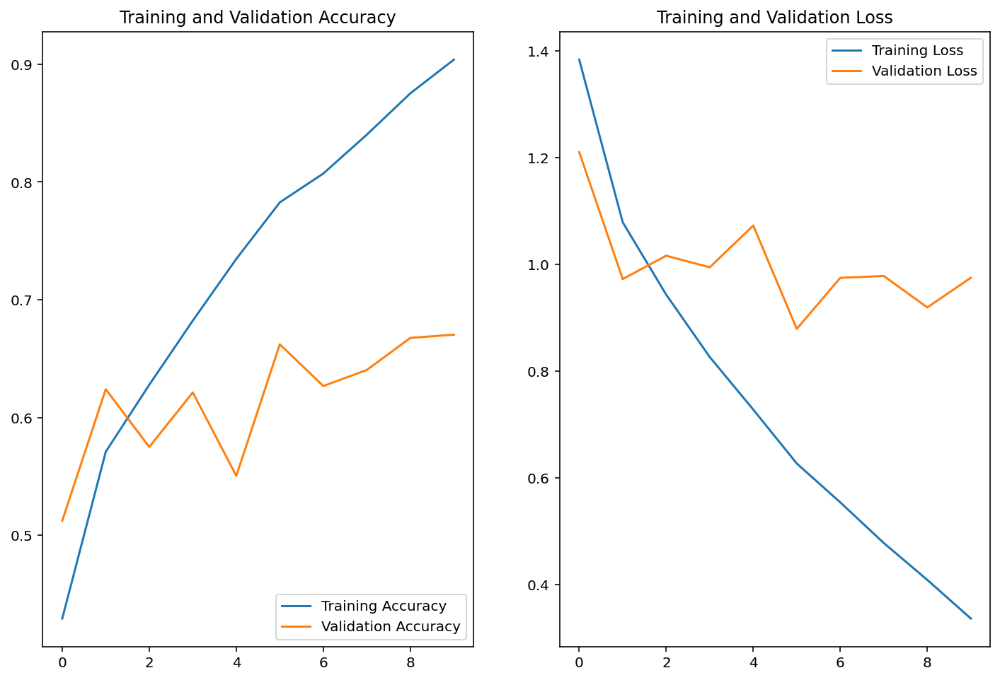

In [23]:
# 학습 결과 시각화
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(EPOCHS)

plt.figure(figsize=(12, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

In [24]:
# 모델 예측 결과 확인
for image_batch, label_batch in test_batches.take(1):
    images = image_batch
    labels = label_batch
    predictions = model.predict(image_batch)
    break

predictions

array([[2.20057485e-03, 6.82943966e-03, 6.20509647e-02, 8.48816931e-01,
        8.01021457e-02],
       [4.42482442e-01, 5.55300951e-01, 1.82399678e-03, 1.23163292e-04,
        2.69420416e-04],
       [5.84601283e-01, 4.10734303e-02, 5.09139262e-02, 3.20447564e-01,
        2.96381884e-03],
       [1.80113792e-01, 1.36685312e-01, 5.38413048e-01, 2.00889241e-02,
        1.24698952e-01],
       [8.74577224e-01, 6.50714487e-02, 1.55412108e-02, 4.48998762e-03,
        4.03200723e-02],
       [2.68652648e-01, 4.73159403e-01, 6.63358569e-02, 5.58377057e-02,
        1.36014357e-01],
       [1.43163865e-02, 4.22057241e-01, 5.34981787e-01, 1.43666957e-02,
        1.42778791e-02],
       [1.16249979e-01, 2.38060176e-01, 8.77682120e-02, 3.37070674e-01,
        2.20850959e-01],
       [1.06287550e-03, 2.15261116e-05, 1.15095393e-03, 9.97733355e-01,
        3.13130186e-05],
       [9.41222072e-01, 5.80109991e-02, 1.07154905e-04, 3.38121026e-05,
        6.26013672e-04],
       [9.24033880e-01, 6.8468

In [26]:
# prediction값들을 실제 추론한 라벨로 변환해보기
import numpy as np

predictions = np.argmax(predictions, axis=1)
predictions

array([3, 1, 0, 2, 0, 1, 2, 3, 3, 0, 0, 3, 3, 4, 0, 3, 2, 3, 1, 0, 2, 0,
       1, 0, 1, 3, 0, 1, 2, 1, 0, 0])

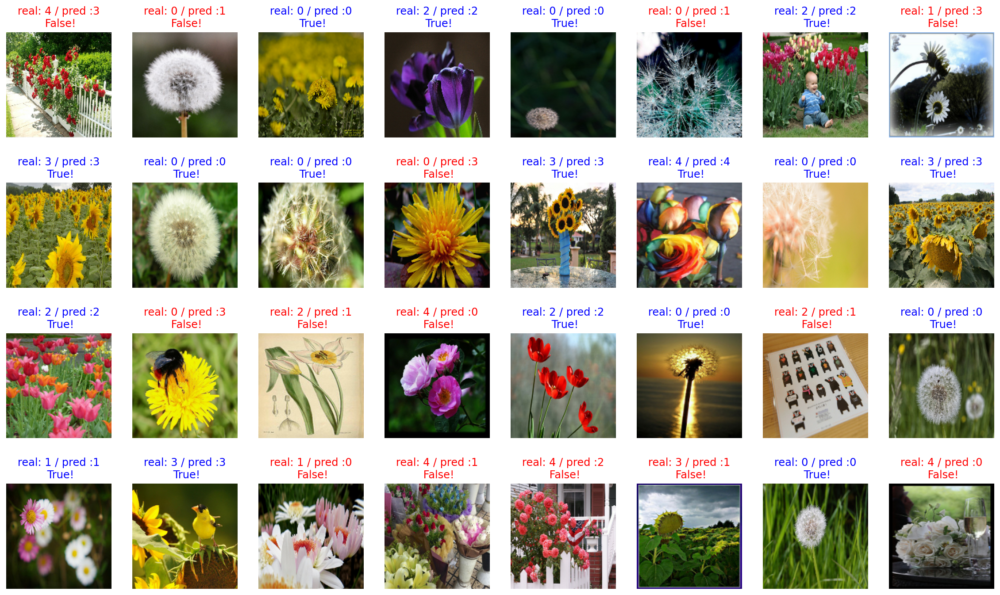

In [27]:
# 32장의 이미지, 라벨, 예측 결과 시각화
plt.figure(figsize=(20, 12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1) / 2  # 이미지 정규화 해제
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label.numpy()} / pred :{prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color': 'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
    plt.axis('off')

plt.show()

In [28]:
# 위 32개 이미지에 대해선 prediction accuracy 계산
count = 0   # 정답을 맞춘 개수
for image, label, prediction in zip(images, labels, predictions):
    correct = label == prediction
    if correct:
        count += 1

print(f"Prediction accuracy for the batch: {count / 32 * 100:.2f}%")

Prediction accuracy for the batch: 56.25%


- 여기까진 한 배치(32개 이미지)에 대해 모델이 예측한 결과를 시각화하고 해당 배치에 대한 예측 정확도 계산
- 다음 코드는 전체 데이터셋에 대해 모델의 성능(loss, accuracy) 평가해보고, 특정 배치에 대해 예측된 결과를 시각화하고 예측된 라벨 확인

In [29]:
# 전체 테스트 데이터셋에서 모델 성능 평가
test_loss, test_accuracy = model.evaluate(test_batches)
print(f"Test Loss: {test_loss:.4f}")
print(f"Test Accuracy: {test_accuracy:.4f}")

12/12 [==============================] - 0s 34ms/step - loss: 1.0386 - accuracy: 0.6322
Test Loss: 1.0386
Test Accuracy: 0.6322


In [30]:
# 테스트 데이터셋에서 새로운 샘플 배치를 가져와 예측 결과 확인
for image_batch, label_batch in test_batches.take(1):
    images = image_batch
    labels = label_batch
    predictions = model.predict(image_batch)
    predictions = tf.argmax(predictions, axis=1)
    break

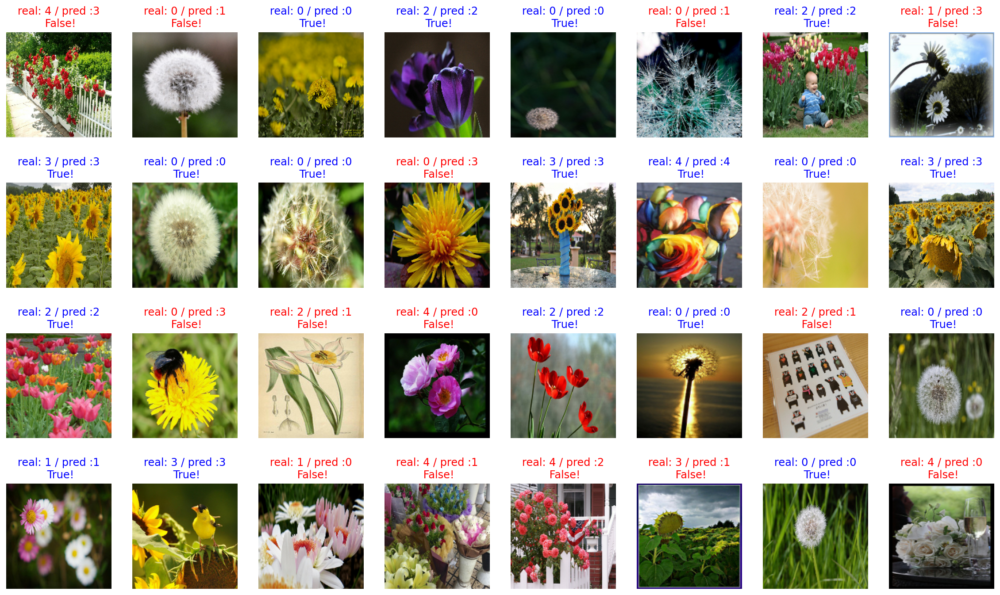

In [31]:
# 새로운 배치의 32개 이미지, 라벨, 예측 결과 시각화
plt.figure(figsize=(20, 12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1) / 2  # 이미지 정규화 해제
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label.numpy()} / pred :{prediction.numpy()}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color': 'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
    plt.axis('off')

plt.show()

In [32]:
# 다른 배치 확인해보기: 테스트 데이터셋에서 두 번째 배치를 가져와 예측 결과 확인
for image_batch, label_batch in test_batches.skip(1).take(1):
    images = image_batch
    labels = label_batch
    predictions = model.predict(image_batch)
    predictions = tf.argmax(predictions, axis=1)
    break

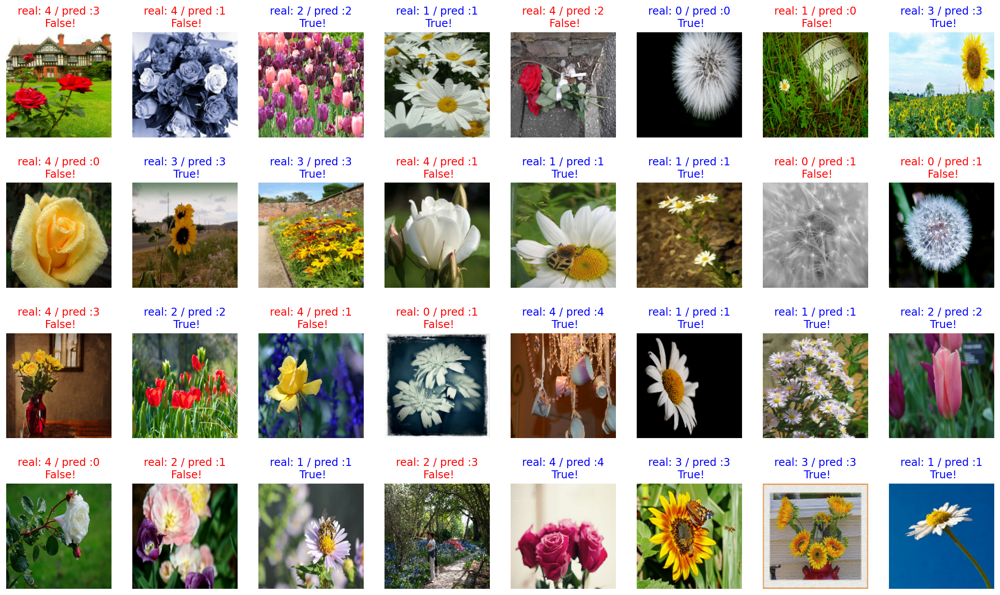

In [33]:
plt.figure(figsize=(20, 12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1) / 2  # 이미지 정규화 해제
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label.numpy()} / pred :{prediction.numpy()}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color': 'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
    plt.axis('off')

plt.show()

# Step 6. 학습된 모델 활용하기

In [34]:
# VGG16 모델 base_model의 변수로 불러오기
IMG_SHAPE = (IMG_SIZE, IMG_SIZE, 3)

# Create the base model from the pre-trained model VGG16
base_model = tf.keras.applications.VGG16(input_shape=IMG_SHAPE,
                                         include_top=False,
                                         weights='imagenet')

58900480/58889256 [==============================] - 0s 0us/step


In [35]:
# image_batch 원래 사이즈 재확인
image_batch.shape

TensorShape([32, 160, 160, 3])

In [36]:
# 모델에 이 배치를 넣으면 shape는
feature_batch = base_model(image_batch)
feature_batch.shape

TensorShape([32, 5, 5, 512])

In [37]:
# 모델 구조 살펴보기
base_model.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 160, 160, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 160, 160, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 160, 160, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 80, 80, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 80, 80, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 80, 80, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 40, 40, 128)       0     

In [38]:
# Global Average Pooling 계층 만드는 코드
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()

In [39]:
# Global Average Pooling 적용 및 출력 크기 확인
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 512)


In [41]:
# Dense Layer와 분류 레이어 생성
dense_layer = tf.keras.layers.Dense(units=512, activation='relu')
prediction_layer = tf.keras.layers.Dense(units=5, activation='softmax')
prediction_batch = prediction_layer(dense_layer(feature_batch_average))  
print(prediction_batch.shape)

(32, 5)


In [42]:
# VGG16 기본 모델 가중치 고정
base_model.trainable = False

In [43]:
# 최종 모델 생성
model = tf.keras.Sequential([
  base_model,
  global_average_layer,
  dense_layer,
  prediction_layer
])

In [44]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 5, 5, 512)         14714688  
_________________________________________________________________
global_average_pooling2d (Gl (None, 512)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 512)               262656    
_________________________________________________________________
dense_3 (Dense)              (None, 5)                 2565      
Total params: 14,979,909
Trainable params: 265,221
Non-trainable params: 14,714,688
_________________________________________________________________


## VGG16기반으로 구성된 이미지 분류기 학습시키고 결과 비교하기

In [45]:
# 모델 정의
# 앞에서 설정한 base_model(VGG16), Global Average Pooling Layer, Dense Layer, predict Layer를
# 하나의 sequential 모델로 구성
model = tf.keras.Sequential([
    base_model,
    global_average_layer,
    dense_layer,
    prediction_layer
])

In [46]:
# 모델이 학습하는데 필요한 학습률 파라미터 설정
learning_rate = 0.0001

# VGG16 모델 컴파일
model.compile(
    optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

In [47]:
# 초기 성능 평가
validation_steps = 20
loss0, accuracy0 = model.evaluate(validation_batches, steps=validation_steps)

print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

12/20 [=================>............] - ETA: 1s - loss: 1.7239 - accuracy: 0.1826WARNING:tensorflow:Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches (in this case, 20 batches). You may need to use the repeat() function when building your dataset.


20/20 [==============================] - 7s 141ms/step - loss: 1.7239 - accuracy: 0.1826
initial loss: 1.72
initial accuracy: 0.18


In [48]:
# 최종 성능 확인을 위해 모델 학습: 데이터 셔플링 및 배치화
BATCH_SIZE = 32
SHUFFLE_BUFFER_SIZE = 1000

train_batches = train.shuffle(SHUFFLE_BUFFER_SIZE).batch(BATCH_SIZE)
validation_batches = validation.batch(BATCH_SIZE)
test_batches = test.batch(BATCH_SIZE)

In [49]:
# 모델 학습
EPOCHS = 5
history = model.fit(train_batches,
                    epochs=EPOCHS,
                    validation_data=validation_batches)

Epoch 1/5
92/92 [==============================] - 11s 110ms/step - loss: 1.3442 - accuracy: 0.5460 - val_loss: 1.1504 - val_accuracy: 0.6431
Epoch 2/5
92/92 [==============================] - 8s 80ms/step - loss: 1.0269 - accuracy: 0.7078 - val_loss: 0.9211 - val_accuracy: 0.6975
Epoch 3/5
92/92 [==============================] - 8s 81ms/step - loss: 0.8539 - accuracy: 0.7527 - val_loss: 0.7788 - val_accuracy: 0.7330
Epoch 4/5
92/92 [==============================] - 8s 82ms/step - loss: 0.7524 - accuracy: 0.7681 - val_loss: 0.7182 - val_accuracy: 0.7548
Epoch 5/5
92/92 [==============================] - 8s 84ms/step - loss: 0.6851 - accuracy: 0.7830 - val_loss: 0.6593 - val_accuracy: 0.7711


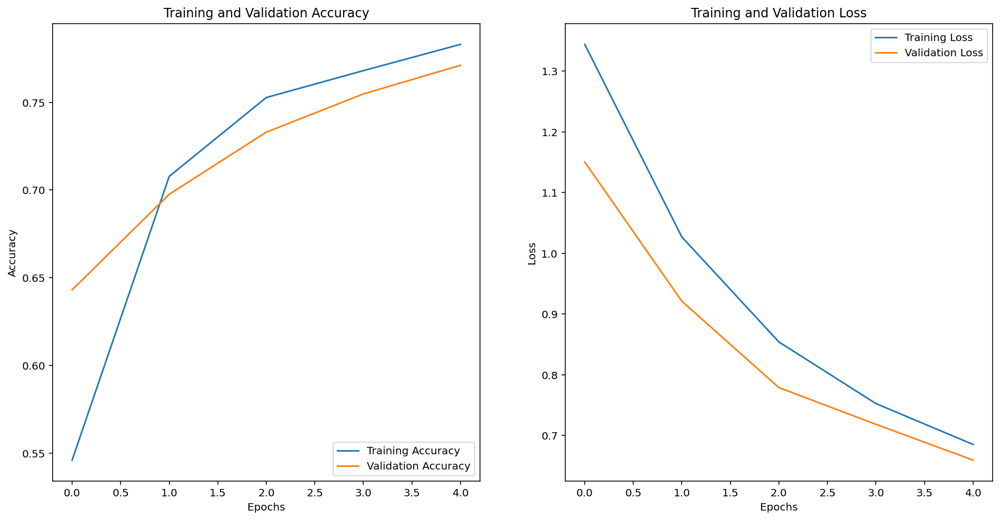

In [50]:
# 학습 과정 시각화

# history 객체에서 저장된 학습 및 검증 정확도와 손실 값 불러오기
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(len(acc))  # 에포크 범위 설정

# 학습 및 검증 정확도 시각화
plt.figure(figsize=(16, 8))

plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')

# 학습 및 검증 손실 시각화
plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')

plt.show()

In [51]:
# 테스트 배치에서 예측 수행
for image_batch, label_batch in test_batches.take(1):
    images = image_batch
    labels = label_batch
    predictions = model.predict(image_batch)
    pass

predictions

array([[7.6950513e-02, 8.3170734e-02, 6.1446208e-01, 9.6493401e-02,
        1.2892322e-01],
       [9.9267757e-01, 4.7554481e-03, 2.9915036e-04, 9.9534984e-04,
        1.2724224e-03],
       [7.4499393e-01, 9.7009391e-02, 4.7746133e-02, 7.7303737e-02,
        3.2946840e-02],
       [1.8666388e-02, 4.1591112e-02, 4.3350944e-01, 2.3383386e-02,
        4.8284972e-01],
       [6.3348019e-01, 2.3301002e-01, 4.5278613e-02, 2.6825285e-02,
        6.1405912e-02],
       [8.8665807e-01, 6.3517094e-02, 1.5540644e-02, 2.6423510e-02,
        7.8606606e-03],
       [6.1945282e-02, 3.2232862e-02, 5.3597724e-01, 2.0055680e-01,
        1.6928782e-01],
       [4.4252130e-01, 2.8053600e-01, 1.0682999e-02, 2.3187116e-01,
        3.4388524e-02],
       [5.9671871e-02, 1.5243191e-02, 7.1892329e-02, 6.9149601e-01,
        1.6169663e-01],
       [9.9812454e-01, 1.2197862e-03, 4.7912781e-05, 4.9503567e-04,
        1.1265697e-04],
       [9.4612169e-01, 3.1245390e-02, 7.6758917e-03, 6.5657725e-03,
        8.39

In [52]:
# 예측 확률을 label로 변환
predictions = np.argmax(predictions, axis=1)
predictions

array([2, 0, 0, 4, 0, 0, 2, 0, 3, 0, 0, 1, 3, 4, 0, 3, 2, 0, 2, 4, 2, 0,
       2, 0, 1, 4, 2, 4, 4, 3, 0, 4])

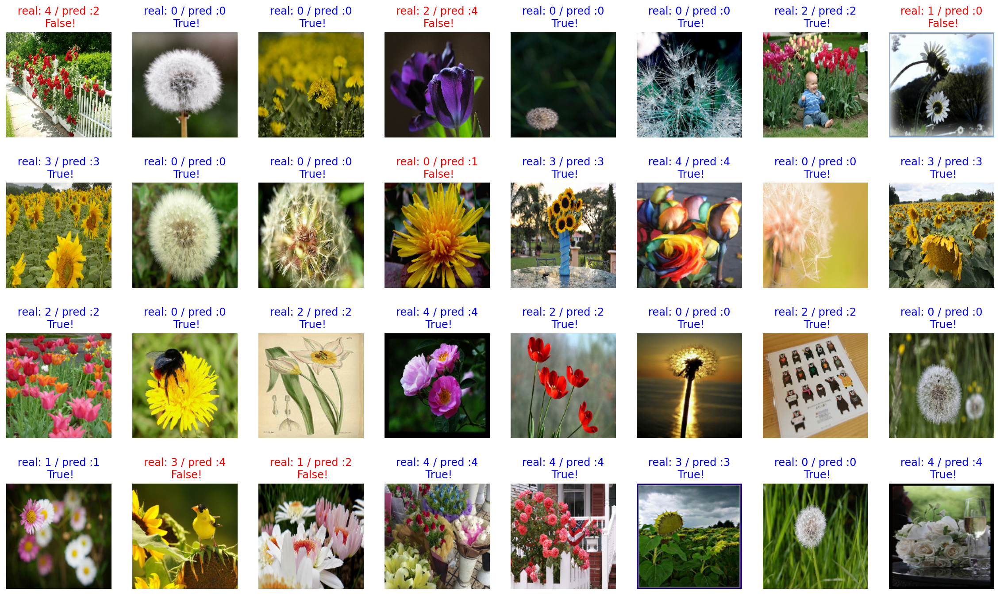

In [53]:
# 예측 결과 시각화
plt.figure(figsize=(20, 12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1) / 2  # 정규화 해제
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label} / pred :{prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color': 'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
    plt.axis('off')

In [54]:
# 32개에 대한 정확도 계산
count = 0
for image, label, prediction in zip(images, labels, predictions):
    correct = label == prediction
    if correct:
        count = count + 1

print(count / 32 * 100)

81.25


# 정확도 올리기 위한 추가 시도

## 1st. epochs 조정

In [60]:
# 에포크 증가
learning_rate = 0.00001
EPOCHS = 10

# VGG16 모델 컴파일
model.compile(
    optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

# 모델 학습
history = model.fit(train_batches,
                    epochs=EPOCHS,
                    validation_data=validation_batches)

Epoch 1/10
92/92 [==============================] - 9s 83ms/step - loss: 0.5074 - accuracy: 0.8396 - val_loss: 0.5417 - val_accuracy: 0.8174
Epoch 2/10
92/92 [==============================] - 8s 80ms/step - loss: 0.5046 - accuracy: 0.8406 - val_loss: 0.5384 - val_accuracy: 0.8147
Epoch 3/10
92/92 [==============================] - 8s 81ms/step - loss: 0.5030 - accuracy: 0.8382 - val_loss: 0.5370 - val_accuracy: 0.8147
Epoch 4/10
92/92 [==============================] - 8s 83ms/step - loss: 0.5012 - accuracy: 0.8389 - val_loss: 0.5362 - val_accuracy: 0.8147
Epoch 5/10
92/92 [==============================] - 8s 84ms/step - loss: 0.4994 - accuracy: 0.8406 - val_loss: 0.5355 - val_accuracy: 0.8174
Epoch 6/10
92/92 [==============================] - 8s 85ms/step - loss: 0.4980 - accuracy: 0.8406 - val_loss: 0.5342 - val_accuracy: 0.8147
Epoch 7/10
92/92 [==============================] - 9s 87ms/step - loss: 0.4964 - accuracy: 0.8420 - val_loss: 0.5329 - val_accuracy: 0.8174
Epoch 8/10
92

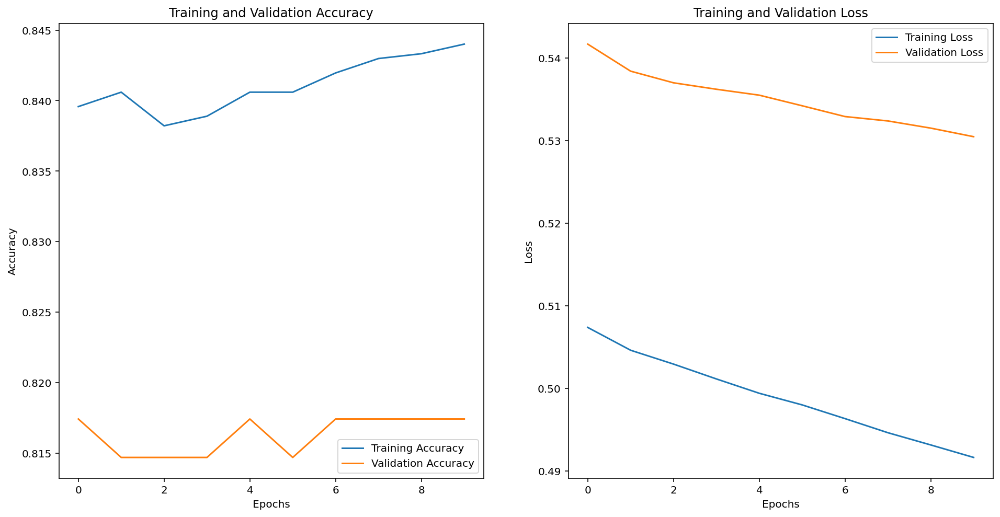

In [61]:
# 학습 과정 시각화
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(len(acc))

plt.figure(figsize=(16, 8))

plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')

plt.show()

In [62]:
# 32개 샘플에 대한 예측 수행 및 정확도 계산
for image_batch, label_batch in test_batches.take(1):
    images = image_batch
    labels = label_batch
    predictions = model.predict(image_batch)
    break

predictions = np.argmax(predictions, axis=1)

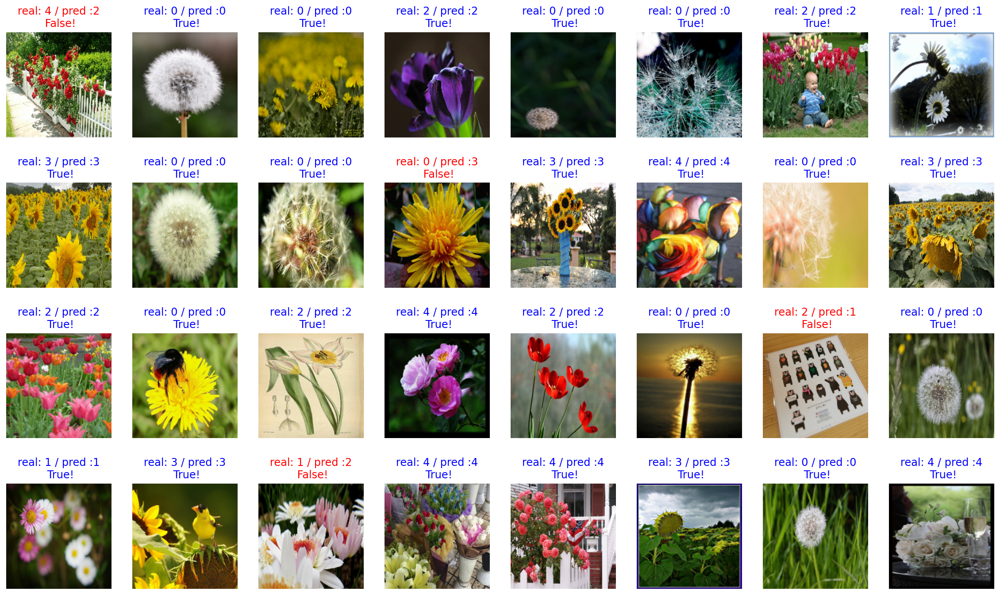

In [63]:
# 예측 결과 시각화 및 정확도 계산
plt.figure(figsize=(20, 12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1) / 2  # 이미지 정규화 해제
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label.numpy()} / pred :{prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color': 'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
    plt.axis('off')

plt.show()

In [64]:
# 32개에 대한 정확도 계산
count = 0
for image, label, prediction in zip(images, labels, predictions):
    if label == prediction:
        count += 1

print(f"Accuracy for the batch: {count / 32 * 100:.2f}%")

Accuracy for the batch: 87.50%


## 2nd. Fine-tuning 추가

In [65]:
# VGG16 모델의 마지막 4개의 레이어를 학습 가능하게 설정
for layer in base_model.layers[-4:]:
    layer.trainable = True

# 미세 조정을 위해 학습률 낮게 설정
learning_rate = 1e-5

# model compile
model.compile(
    optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

# Fine-Tuning 모델 학습
EPOCHS = 10

history = model.fit(train_batches,
                    epochs=EPOCHS,
                    validation_data=validation_batches)

Epoch 1/10
92/92 [==============================] - 9s 81ms/step - loss: 0.4900 - accuracy: 0.8440 - val_loss: 0.5294 - val_accuracy: 0.8202
Epoch 2/10
92/92 [==============================] - 8s 80ms/step - loss: 0.4883 - accuracy: 0.8450 - val_loss: 0.5283 - val_accuracy: 0.8229
Epoch 3/10
92/92 [==============================] - 8s 81ms/step - loss: 0.4869 - accuracy: 0.8457 - val_loss: 0.5269 - val_accuracy: 0.8229
Epoch 4/10
92/92 [==============================] - 8s 83ms/step - loss: 0.4853 - accuracy: 0.8454 - val_loss: 0.5262 - val_accuracy: 0.8202
Epoch 5/10
92/92 [==============================] - 8s 84ms/step - loss: 0.4839 - accuracy: 0.8464 - val_loss: 0.5254 - val_accuracy: 0.8202
Epoch 6/10
92/92 [==============================] - 8s 87ms/step - loss: 0.4823 - accuracy: 0.8464 - val_loss: 0.5234 - val_accuracy: 0.8202
Epoch 7/10
92/92 [==============================] - 8s 87ms/step - loss: 0.4809 - accuracy: 0.8488 - val_loss: 0.5230 - val_accuracy: 0.8174
Epoch 8/10
92

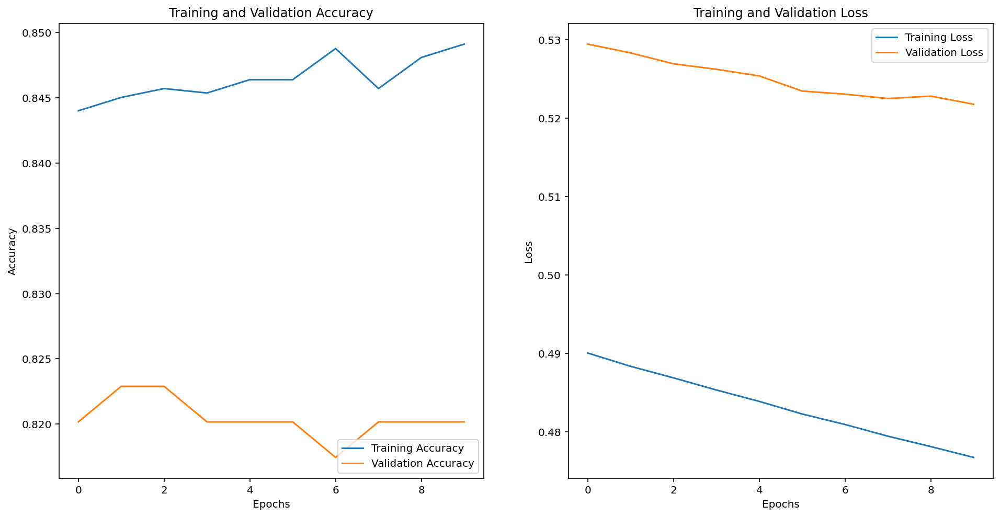

In [66]:
# 학습 과정 시각화
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(len(acc))

plt.figure(figsize=(16, 8))

plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')

plt.show()

In [67]:
# # 32개 샘플에 대한 예측 수행 및 정확도 계산
# for image_batch, label_batch in test_batches.take(1):
#     images = image_batch
#     labels = label_batch
#     predictions = model.predict(image_batch)
#     break

# predictions = np.argmax(predictions, axis=1)

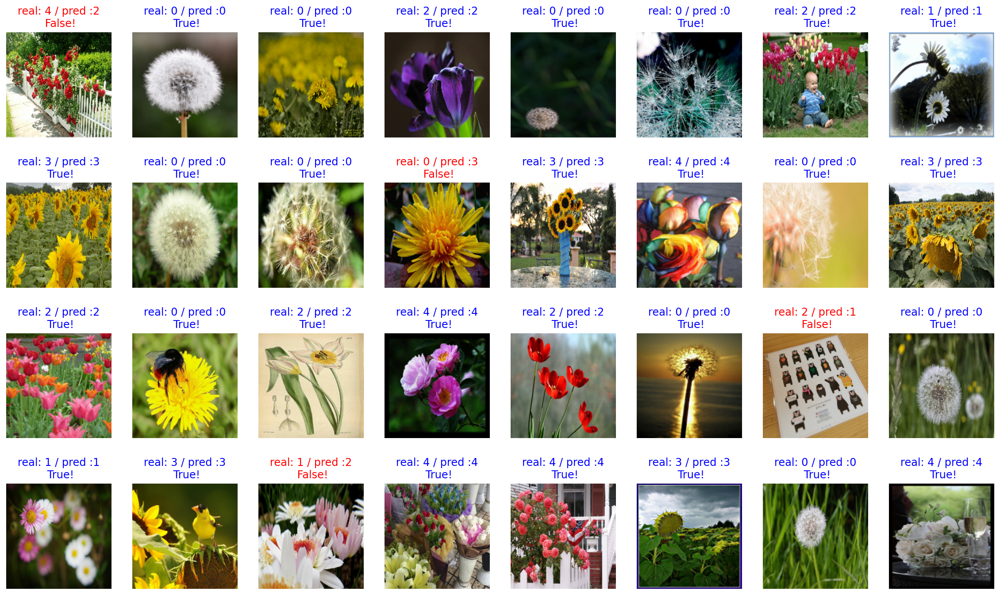

In [68]:
# # 예측 결과 시각화 및 정확도 계산
# plt.figure(figsize=(20, 12))

# for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
#     plt.subplot(4, 8, idx+1)
#     image = (image + 1) / 2  # 이미지 정규화 해제
#     plt.imshow(image)
#     correct = label == prediction
#     title = f'real: {label.numpy()} / pred :{prediction}\n {correct}!'
#     if not correct:
#         plt.title(title, fontdict={'color': 'red'})
#     else:
#         plt.title(title, fontdict={'color': 'blue'})
#     plt.axis('off')

# plt.show()

In [69]:
# # 32개에 대한 정확도 계산
# count = 0
# for image, label, prediction in zip(images, labels, predictions):
#     if label == prediction:
#         count += 1

# print(f"Accuracy for the batch: {count / 32 * 100:.2f}%")

Accuracy for the batch: 87.50%


### WARNING 피하기 위해 model.predict 루프 밖으로 이동하고 예측 한 번에 수행하도록 수정

In [70]:
# 32개 샘플에 대한 예측 수행: 루프 밖에서 한 번에 수행하도록
for image_batch, label_batch in test_batches.take(1):
    images = image_batch
    labels = label_batch
    predictions = model.predict(images)
    predictions = np.argmax(predictions, axis=1)

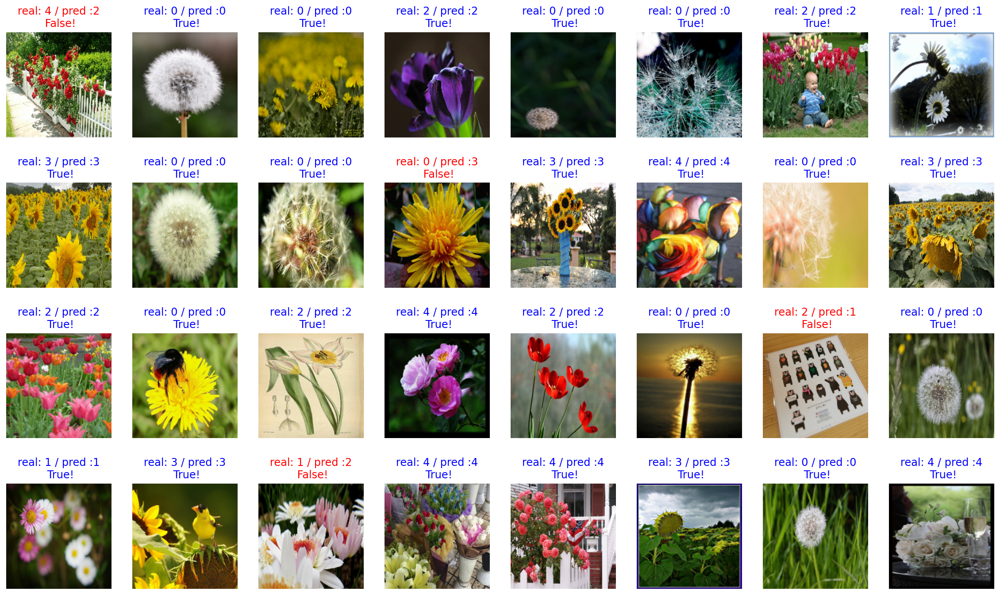

In [71]:
# 예측 결과 시각화 및 정확도 계산
plt.figure(figsize=(20, 12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1) / 2  # 이미지 정규화 해제
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label.numpy()} / pred :{prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color': 'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
    plt.axis('off')

plt.show()

In [72]:
# 32개에 대한 정확도 계산
count = 0
for image, label, prediction in zip(images, labels, predictions):
    if label == prediction:
        count += 1

print(f"Accuracy for the batch: {count / 32 * 100:.2f}%")

Accuracy for the batch: 87.50%


- 동일한 87.50%. 결국 큰 차이 없는 걸로...

# 3rd. epochs 수 추가 조정
## epochs 10 -> 20, early stopping 적용

In [73]:
from tensorflow.keras.callbacks import EarlyStopping

# early stopping 적용
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

# Fine-Tuning 모델 학습 + epochs 수 증가
EPOCHS = 20

history = model.fit(train_batches,
                    epochs=EPOCHS,
                    validation_data=validation_batches,
                    callbacks=[early_stopping])

Epoch 1/20
92/92 [==============================] - 8s 79ms/step - loss: 0.4753 - accuracy: 0.8508 - val_loss: 0.5199 - val_accuracy: 0.8202
Epoch 2/20
92/92 [==============================] - 8s 82ms/step - loss: 0.4741 - accuracy: 0.8484 - val_loss: 0.5196 - val_accuracy: 0.8202
Epoch 3/20
92/92 [==============================] - 8s 83ms/step - loss: 0.4727 - accuracy: 0.8498 - val_loss: 0.5180 - val_accuracy: 0.8256
Epoch 4/20
92/92 [==============================] - 8s 82ms/step - loss: 0.4714 - accuracy: 0.8508 - val_loss: 0.5168 - val_accuracy: 0.8256
Epoch 5/20
92/92 [==============================] - 8s 83ms/step - loss: 0.4699 - accuracy: 0.8484 - val_loss: 0.5172 - val_accuracy: 0.8202
Epoch 6/20
92/92 [==============================] - 8s 83ms/step - loss: 0.4687 - accuracy: 0.8498 - val_loss: 0.5165 - val_accuracy: 0.8229
Epoch 7/20
92/92 [==============================] - 8s 85ms/step - loss: 0.4675 - accuracy: 0.8515 - val_loss: 0.5154 - val_accuracy: 0.8256
Epoch 8/20
92

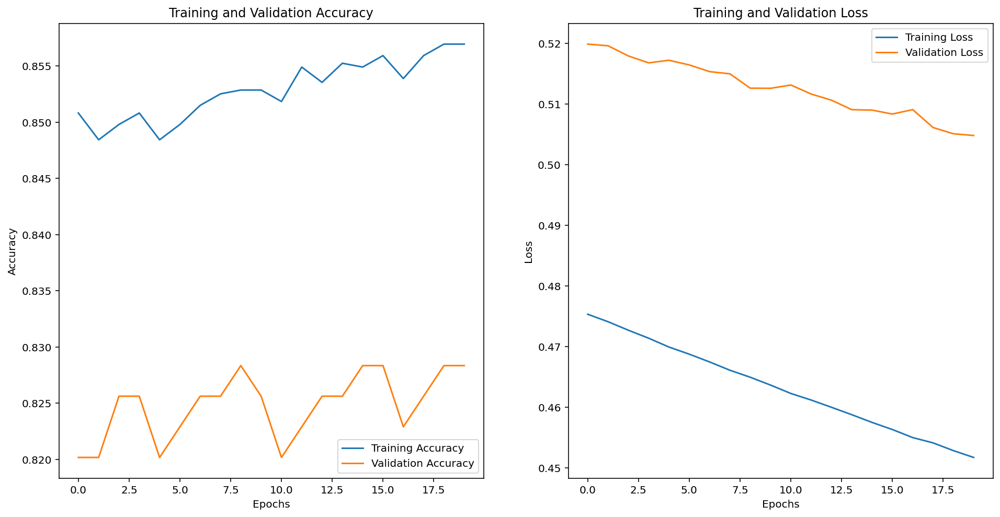

In [74]:
# 학습 과정 시각화
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(len(acc))

plt.figure(figsize=(16, 8))

plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')

plt.show()

In [75]:
# 32개 샘플에 대한 예측 수행 및 정확도 계산
for image_batch, label_batch in test_batches.take(1):
    images = image_batch
    labels = label_batch
    predictions = model.predict(images)
    predictions = np.argmax(predictions, axis=1)

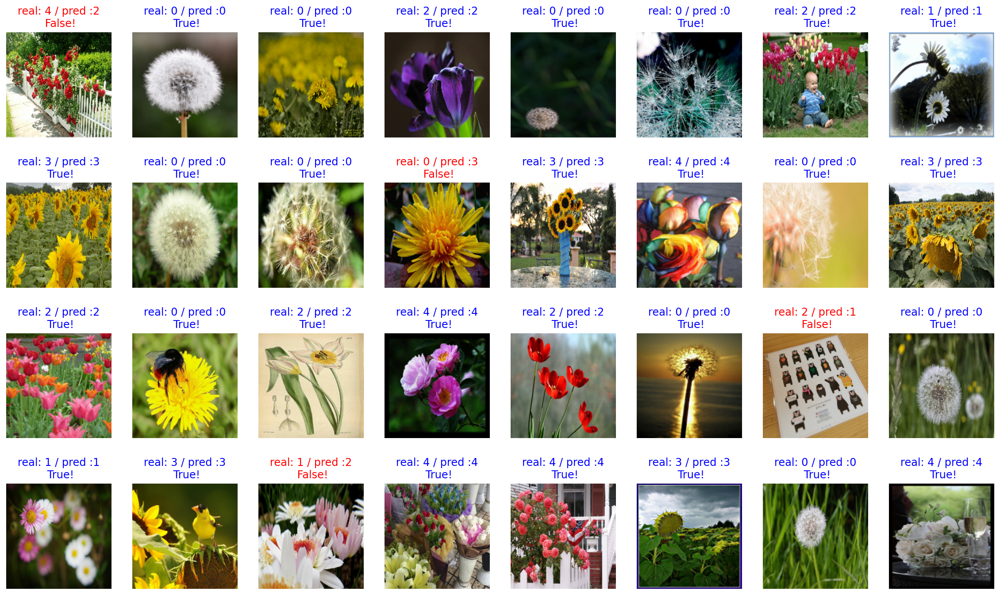

In [76]:
# 예측 결과 시각화 및 정확도 계산
plt.figure(figsize=(20, 12))

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4, 8, idx+1)
    image = (image + 1) / 2
    plt.imshow(image)
    correct = label == prediction
    title = f'real: {label.numpy()} / pred :{prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color': 'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
    plt.axis('off')

plt.show()

In [77]:
# 32개에 대한 정확도 계산
count = 0
for image, label, prediction in zip(images, labels, predictions):
    if label == prediction:
        count += 1

print(f"Accuracy for the batch: {count / 32 * 100:.2f}%")

Accuracy for the batch: 87.50%
